In [ ]:
knitr::opts_chunk$set(echo = TRUE)
knitr::opts_chunk$set(knitr.purl.inline = FALSE)

In [1]:
options(bitmapType="cairo")

### Import phyloseq object
rds format

In [2]:
library(phyloseq)
library(tidyverse)
ps <- readRDS(file = "~/storage/al_R/rf/ps.f.dec.rds")
ps

-- Attaching packages --------------------------------------- tidyverse 1.3.0 --
v ggplot2 3.3.2     v purrr   0.3.4
v tibble  3.0.3     v dplyr   1.0.0
v tidyr   1.1.0     v stringr 1.4.0
v readr   1.3.1     v forcats 0.5.0
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()


phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 10013 taxa and 62 samples ]
sample_data() Sample Data:       [ 62 samples by 111 sample variables ]
tax_table()   Taxonomy Table:    [ 10013 taxa by 7 taxonomic ranks ]
phy_tree()    Phylogenetic Tree: [ 10013 tips and 10012 internal nodes ]

### nice rownames 

In [3]:
sample_names(ps) <- paste0(ps@sam_data$Description, "_", stringr::str_split_fixed(sample_names(ps), "elimov.", 2)[,2])
ps@sam_data

,Filename,Description,Plant,Inoculation,Al,BineM,SeedM,BineSeedM,SeedN,SeedMOne,...,BineSeedPerPlantFe,BineSeedPerPlantK,BineSeedPerPlantMg,BineSeedPerPlantMo,BineSeedPerPlantNi,BineSeedPerPlantP,BineSeedPerPlantS,BineSeedPerPlantS.1,BineSeedPerPlantZn,QRTPCR
s1903_In_10,belimov-10_S146,s1903_In,s1903,+,-,5.405000,4.735000,10.140,39,121.41026,...,1137.9516,688.9885,75.23185,91.33889,164.06402,107.84265,230.59168,54.60445,323.80829,8685.0
s1903_In_11,belimov-11_S147,s1903_In,s1903,+,-,5.205000,4.070000,9.275,38,107.10526,...,1235.8447,625.7594,70.57403,92.00368,174.41464,102.01957,206.88516,50.88006,280.94555,1058.0
s1903_In_12,belimov-12_S148,s1903_In,s1903,+,-,6.450000,5.470000,11.920,36,151.94444,...,902.3528,823.8674,94.10822,90.51768,207.04061,128.73955,202.08628,68.26628,311.80069,788.1
s1903_In_Al_13,belimov-13_S149,s1903_In_Al,s1903,+,+,6.480000,4.280000,10.760,31,138.06452,...,882.7263,1036.0167,85.20478,102.97887,432.09305,31.30442,204.78988,69.35860,193.27373,2116.0
s1903_In_Al_14,belimov-14_S150,s1903_In_Al,s1903,+,+,6.280000,5.025000,11.305,38,132.23684,...,938.9473,1024.1932,85.11361,103.49388,435.84615,34.00642,170.61872,69.99287,253.25384,6881.0
s1903_In_Al_15,belimov-15_S151,s1903_In_Al,s1903,+,+,5.010000,4.510000,9.520,39,115.64103,...,782.8047,866.6926,74.23142,92.81777,370.49559,27.31305,223.08093,60.88558,197.32016,6895.0
s1903_In_Al_16,belimov-16_S152,s1903_In_Al,s1903,+,+,5.730000,4.560000,10.290,33,138.18182,...,734.3385,798.1783,74.72594,93.21318,346.20739,27.17202,230.89644,57.95341,178.11527,1293.0
s7307_17,belimov-17_S153,s7307,s7307,-,-,5.483333,9.456667,14.940,36,262.68519,...,1238.5957,523.8868,71.70796,121.68793,187.25114,51.71888,347.74380,43.37692,321.56844,9420.0
s7307_18,belimov-18_S154,s7307,s7307,-,-,7.340000,9.185000,16.525,38,241.71053,...,1430.3015,663.5034,92.11257,132.95777,235.09253,68.42807,357.95722,54.16634,306.55587,4897.0
s7307_19,belimov-19_S155,s7307,s7307,-,-,6.860000,10.075000,16.935,41,245.73171,...,1219.0293,670.7035,86.88611,115.20924,208.59362,57.53151,296.72312,54.80033,352.74447,1298.0


###Alpha richess
1903 без In - неадекватная кривая разрежения
Удалить s8473_In_41

Loading required package: ggforce
`geom_smooth()` using formula 'y ~ x'


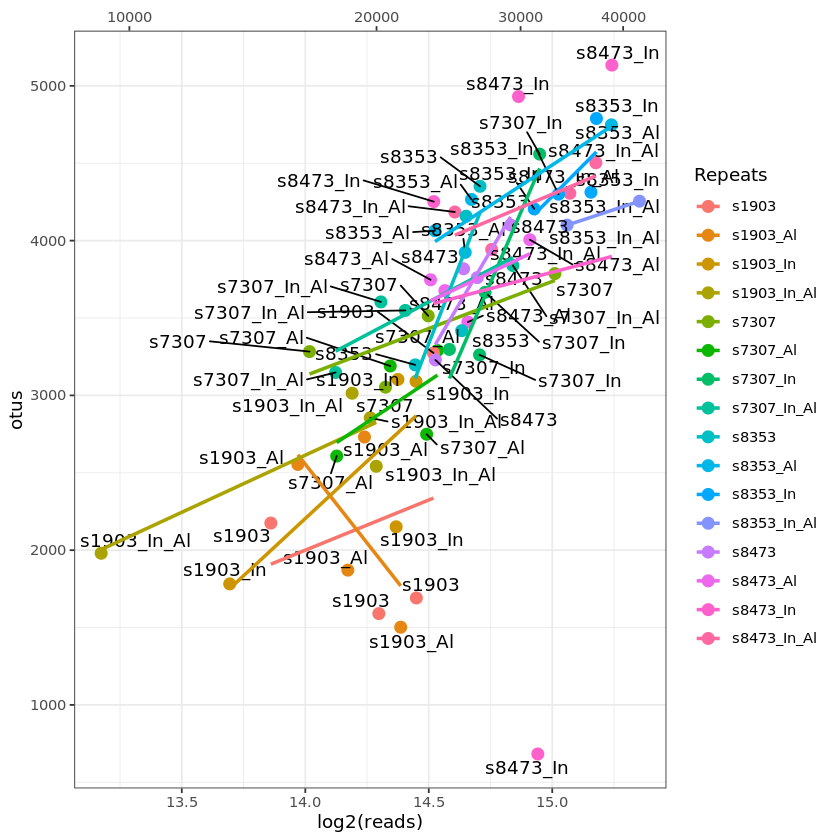

In [4]:
plot_rich_reads_samlenames_lm <- function(ps.f){
  rish <- estimate_richness(ps.f, measures = "Observed")
  reads.sum <- as.data.frame(sample_sums(ps.f))
  reads.summary <- cbind(rish, reads.sum)
  colnames(reads.summary) <- c("otus","reads")
  reads.summary["Description"] <- rownames(ps.f@sam_data)
  reads.summary["Repeats"] <- ps.f@sam_data$Description
  reads.summary["Plant"] <- ps.f@sam_data$Plant
  library(ggrepel)
  require(ggforce)
  p1 <- ggplot(data=reads.summary) + geom_point(aes(y=otus, x=log2(reads), color=Repeats),size=3) + geom_text_repel(aes(y=otus, x=log2(reads), label=Repeats)) + theme_bw()+
    geom_smooth(aes(y=otus, x=log2(reads), fill=Repeats, color=Repeats),method=lm, se=FALSE, ymin = 1) + scale_x_continuous(sec.axis = sec_axis(sec.axis ~ 2**.)) 
  # geom_mark_ellipse(aes(y = otus, x=reads, group = Repeats, label = Repeats, color = Repeats), label.fontsize = 10, label.buffer = unit(2, "mm"), label.minwidth = unit(5, "mm"),con.cap = unit(0.1, "mm"))
  
  return(p1)
}

plot_rich_reads_samlenames_lm(ps)
ps.f <-  subset_samples(ps, sample_names(ps) != 's8473_In_41')
ps.f <- prune_taxa(taxa_sums(ps.f) > 0,ps.f)
p.rich.f = plot_rich_reads_samlenames_lm(ps.f)

`geom_smooth()` using formula 'y ~ x'


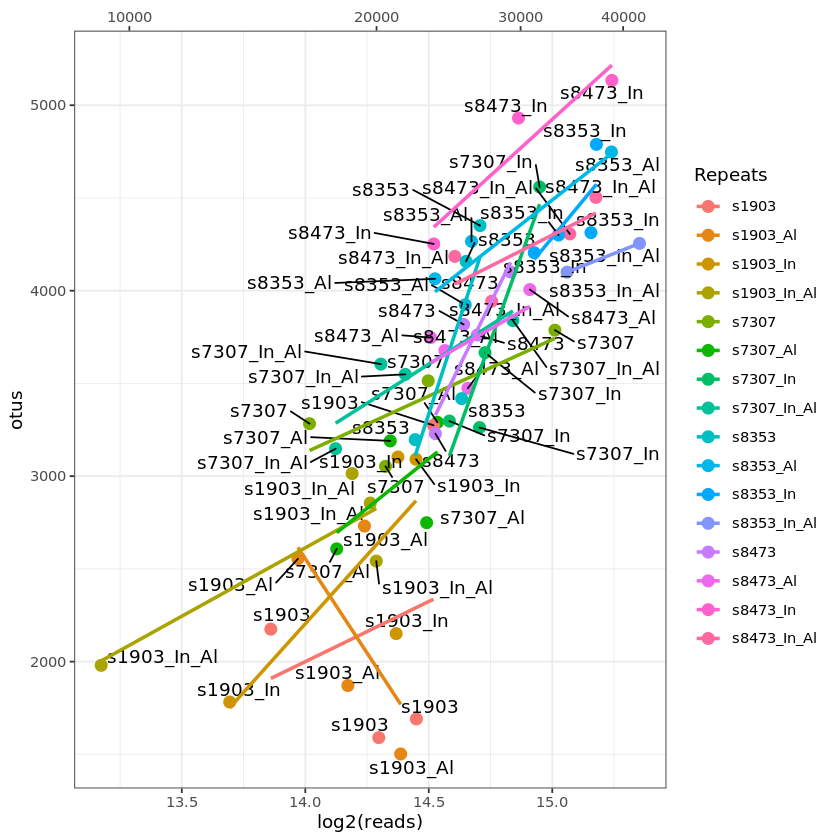

In [14]:
p.rich.f

###Split

In [ ]:
ps.f.s1903 <- prune_samples(sample_data(ps.f)$Plant %in% c("s1903"), ps.f)
ps.f.s1903 <- prune_taxa(taxa_sums(ps.f.s1903) > 0,ps.f.s1903)

ps.f.s7307 <- prune_samples(sample_data(ps.f)$Plant %in% c("s7307"), ps.f)
ps.f.s7307 <- prune_taxa(taxa_sums(ps.f.s7307) > 0,ps.f.s7307)

ps.f.s8473 <- prune_samples(sample_data(ps.f)$Plant %in% c("s8473"), ps.f)
ps.f.s8473 <- prune_taxa(taxa_sums(ps.f.s8473) > 0,ps.f.s8473)

ps.f.s8353 <- prune_samples(sample_data(ps.f)$Plant %in% c("s8353"), ps.f)
ps.f.s8353 <- prune_taxa(taxa_sums(ps.f.s8353) > 0,ps.f.s8353)

# physeq <- ps.f.s1903
# physeq@sam_data$Al
# 
# physeq.Al.pos <- prune_samples(sample_data(physeq)$Al %in% c("pos"), physeq)
# physeq.Al.pos <- prune_taxa(taxa_sums(physeq.Al.pos) > 0, physeq.Al.pos)
# 
# physeq.Al.neg <- prune_samples(sample_data(physeq)$Al %in% c("neg"),physeq)
# physeq.Al.neg <- prune_taxa(taxa_sums(physeq.Al.neg) > 0, physeq.Al.neg)
# 
# physeq.In.pos <- prune_samples(sample_data(physeq)$Inoculation %in% c("pos"), physeq)
# physeq.In.pos <- prune_taxa(taxa_sums(physeq.In.pos) > 0,physeq.In.pos)
# 
# physeq.In.neg <- prune_samples(sample_data(physeq)$Inoculation %in% c("pos"), physeq)
# physeq.In.neg <- prune_taxa(taxa_sums(physeq.In.neg) > 0,physeq.In.neg)

###Beta
####Colour - plants
Цвета для генотипов растений

Loading required package: DESeq2
Loading required package: S4Vectors
Loading required package: stats4
Loading required package: BiocGenerics
Loading required package: parallel

Attaching package: 'BiocGenerics'

The following objects are masked from 'package:parallel':

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB

The following objects are masked from 'package:dplyr':

    combine, intersect, setdiff, union

The following objects are masked from 'package:stats':

    IQR, mad, sd, var, xtabs

The following objects are masked from 'package:base':

    Filter, Find, Map, Position, Reduce, anyDuplicated, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, set

Wisconsin double standardization
Run 0 stress 0.12765 
Run 1 stress 0.1274956 
... New best solution
... Procrustes: rmse 0.04316356  max resid 0.2385125 
Run 2 stress 0.13619 
Run 3 stress 0.1451334 
Run 4 stress 0.1433716 
Run 5 stress 0.1394112 
Run 6 stress 0.1295 
Run 7 stress 0.127622 
... Procrustes: rmse 0.04294468  max resid 0.2389469 
Run 8 stress 0.1286075 
Run 9 stress 0.1301693 
Run 10 stress 0.1285487 
Run 11 stress 0.1311058 
Run 12 stress 0.1276221 
... Procrustes: rmse 0.04294818  max resid 0.2389983 
Run 13 stress 0.1332949 
Run 14 stress 0.127622 
... Procrustes: rmse 0.04294249  max resid 0.2389529 
Run 15 stress 0.1281111 
Run 16 stress 0.1394146 
Run 17 stress 0.1333134 
Run 18 stress 0.145505 
Run 19 stress 0.1294999 
Run 20 stress 0.1285853 
*** No convergence -- monoMDS stopping criteria:
    20: stress ratio > sratmax
Run 0 stress 0.1836237 
Run 1 stress 0.1965177 
Run 2 stress 0.1954372 
Run 3 stress 0.1943109 
Run 4 stress 0.2095384 
Run 5 stress 0.2113238 


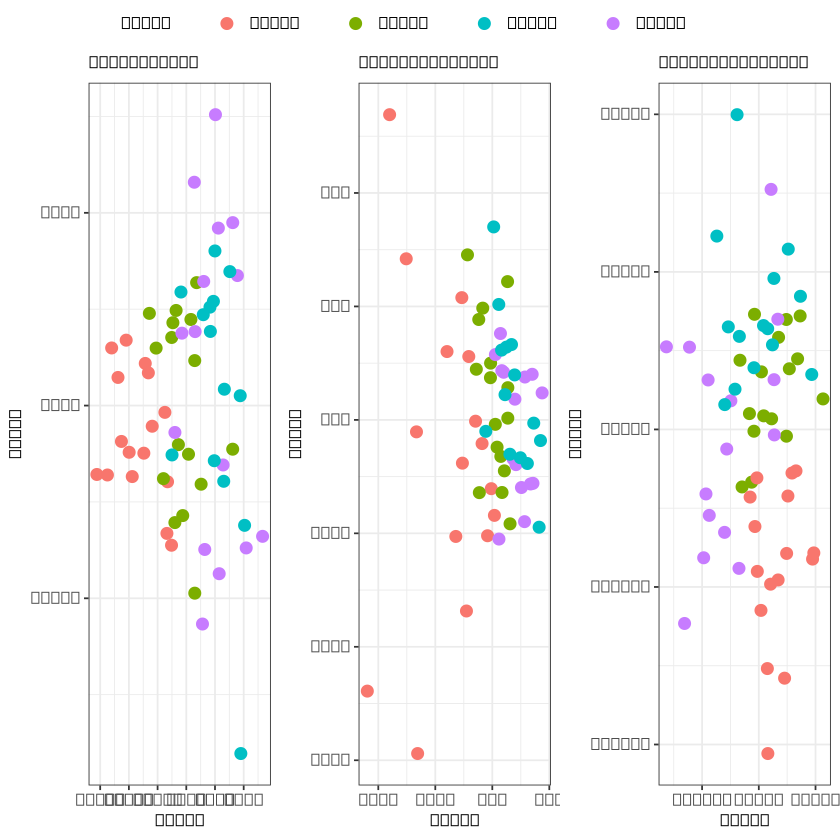

In [13]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="Plant", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="Plant", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="Plant", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)

####Colour - Al

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="pH", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="pH", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="pH", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)

####Colour - Inoculation

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="Inoculation", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="Inoculation", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="Inoculation", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)

####Colour - Mic

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="Mic", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="Mic", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="Mic", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)

####Colour - SeedMg

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="SoilAl", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="SoilAl", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="SoilAl", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)


####Colour - SoilK

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="SoilK", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="SoilK", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="SoilK", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) 
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f)

###PERMANOVA All
Сначала для всего

In [ ]:
permanova.forloop.noNestedPlant <- function(factor){
  require(vegan)
  require(phyloseq)
  dist <- phyloseq::distance(physeq, "bray")
  metadata <- as(sample_data(physeq@sam_data), "data.frame")
  ad <- adonis2(as.formula(paste( "dist ~ ", factor)), data = metadata)
  ad <- cbind2(ad[1,][3], ad[1,][5])
  return(ad)
}
physeq <- ps.f
permanova.forloop.pos.noPlant <- possibly(permanova.forloop.noNestedPlant, otherwise = NA)
out <- map(colnames(physeq@sam_data[,3:111]), permanova.forloop.pos.noPlant)
out.d.noPlant <- do.call("rbind", out)
out.d.noPlant[order(out.d.noPlant$R2, decreasing = TRUE),]


###PERMANOVA Plant
Достоверность линейной вариации бета-разнообразия сообщества(Брей) в зависимости от факторов при разделении по генотипу растений.
Description - description
Достоверность после пермутаций для Фишера высокая, но низкий коэффицент детерминации(мало объяснённой дисперсии) для большой доли факторов. CCA нецелесообразен.

In [ ]:
permanova.forloop <- function(factor){
  require(vegan)
  require(phyloseq)
  dist <- phyloseq::distance(physeq, "bray")
  metadata <- as(sample_data(physeq@sam_data), "data.frame")
  ad <- adonis2(as.formula(paste( "dist ~", "Plant/", factor)), data = metadata)
  ad <- cbind2(ad[2,][3], ad[2,][5])
  return(ad)
}
physeq <- ps.f
permanova.forloop.pos <- possibly(permanova.forloop, otherwise = NA)
out <- map(colnames(physeq@sam_data[,3:111]), permanova.forloop.pos)
out.d <- do.call("rbind", out)
out.d[order(out.d$R2, decreasing = TRUE),]



###Preprocessing tree

###TREE diff

###7307
####Split

In [ ]:
beta_custom_norm_NMDS_elli <- function(ps, seed = 7888, normtype="vst", color="Repeats"){
  require(phyloseq)
  require(ggplot2)
  require(ggpubr)
  require(DESeq2)
  library(ggforce)
  
  
  # beta_NMDS <- function(){
  #normalisation. unifrac - rarefaction; wunifrac,bray - varstab
  
  diagdds = phyloseq_to_deseq2(ps, ~ Description)                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  if (normtype =="vst")
    pst <- varianceStabilizingTransformation(diagdds)
  if (normtype =="log") 
    pst <- rlogTransformation(diagdds)
  
  pst.dimmed <- t(as.matrix(assay(pst))) 
  pst.dimmed[pst.dimmed < 0.0] <- 0.0
  ps.varstab <- ps
  otu_table(ps.varstab) <- otu_table(pst.dimmed, taxa_are_rows = FALSE) 
  
  ps.rand <- rarefy_even_depth(ps, rngseed = seed)
  
  #beta and ordination
  
  ordination.b <- ordinate(ps.varstab, "NMDS", "bray")
  ordination.u <- ordinate(ps.rand, "NMDS", "unifrac")
  ordination.w <- ordinate(ps.varstab, "NMDS", "wunifrac")
  
  #plotting
  p1 = plot_ordination(ps, ordination.b, type="sample", color="Description", title="NMDS - Bray", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) +
    geom_mark_ellipse(aes(group = Description, label = Description), label.fontsize = 10, label.buffer = unit(2, "mm"), label.minwidth = unit(5, "mm"),con.cap = unit(0.1, "mm"))
  
  p2 = plot_ordination(ps, ordination.u, type="sample", color="Description", title="NMDS - unifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) +
    geom_mark_ellipse(aes(group = Description, label = Description), label.fontsize = 10, label.buffer = unit(2, "mm"), label.minwidth = unit(5, "mm"),con.cap = unit(0.1, "mm"))
  
  p3 = plot_ordination(ps, ordination.w, type="sample", color="Description", title="NMDS - wunifrac", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) + geom_point(size = 3) + 
    geom_mark_ellipse(aes(group = Description, label = Description), label.fontsize = 10, label.buffer = unit(2, "mm"), label.minwidth = unit(5, "mm"),con.cap = unit(0.1, "mm"))
  
  #merge by ggpubr
  
  p.all <- ggarrange(p1, p2, p3, ncol = 3 , nrow = 1, common.legend = TRUE, legend = "none", font.label = list(size = 12, face = "bold", color ="black"))
  
  return(p.all)
}

beta_custom_norm_NMDS_elli(ps.f.s7307)

In [ ]:
physeq <- ps.f.s7307
permanova.forloop.pos.noPlant <- possibly(permanova.forloop.noNestedPlant, otherwise = NA)
out <- map(colnames(physeq@sam_data[,3:111]), permanova.forloop.pos.noPlant)
out.d.noPlant <- do.call("rbind", out)
out.d.noPlant[order(out.d.noPlant$R2, decreasing = TRUE),]

####Shitty alpha violins

In [ ]:
library(ggpubr)
alpha.custom <- function(ps.f.i, arrga = "PD"){
  require(picante)
  pd <- pd(ps.f.i@otu_table@.Data, ps.f.i@phy_tree)
  
  pd1 <- estimate_richness(ps.f.i, measures=c("Observed", "InvSimpson", "Shannon"))
  pd <- cbind(pd,ps.f.i@sam_data, pd1 )
  
  bmi <- levels(as.factor(pd$Description))
  bmi.pairs <- combn(seq_along(bmi), 2, simplify = FALSE, FUN = function(i)bmi[i])
  p1 <- ggviolin(pd, x = "Description", y = arrga,
                 add = "boxplot", fill = "Description") + stat_compare_means(comparisons = bmi.pairs, method = "wilcox.test") +
    scale_x_discrete(limits = c("s7307","s7307_In",  "s7307_Al",  "s7307_In_Al")) + theme(axis.title.x = element_blank(), legend.title = element_blank())
  return(p1)
}

p.alpha.Cdt.oo <- alpha.custom(physeq, arrga = "Observed")
p.alpha.Cdt.sh <- alpha.custom(physeq, arrga = "Shannon")
p.alpha.Cdt.is <- alpha.custom(physeq, arrga = "InvSimpson")
p.alpha.Cdt.pd <- alpha.custom(physeq, arrga = "PD")


p1 <- ggarrange(p.alpha.Cdt.oo, p.alpha.Cdt.sh,p.alpha.Cdt.is, p.alpha.Cdt.pd , ncol = 4 ,label.x = 0.105, nrow = 1, common.legend = TRUE)
p1


###Split dataset by Al and In

In [ ]:
physeq <- subset_taxa(physeq, !is.na(Phylum))


physeq.In <- prune_samples(sample_data(physeq)$Inoculation %in% c("+"), physeq)
physeq.In  <- prune_taxa(taxa_sums(physeq.In) > 0, physeq.In)

physeq.wIn <- prune_samples(sample_data(physeq)$Inoculation %in% c("-"), physeq)
physeq.wIn  <- prune_taxa(taxa_sums(physeq.wIn) > 0, physeq.wIn)


####Correct Al/In meta

In [ ]:
physeq.In@sam_data$Al <- c("neg", "neg", "neg", "neg", "pos", "pos", "pos", "pos")
physeq.wIn@sam_data$Al <- c("neg", "neg", "neg", "neg", "pos", "pos", "pos", "pos")


####Improve on des function - add a required factor(with as.formula function)

In [ ]:
des_w_simper <- function(ps, factor){
  require(DESeq2)
  require(vegan)
  require(tibble)
  
  diagdds = phyloseq_to_deseq2(ps, as.formula(paste( "~", factor)))                  
  diagdds = estimateSizeFactors(diagdds, type="poscounts")
  diagdds = estimateDispersions(diagdds, fitType = "local") 
  diagdds = DESeq(diagdds)
  samp <-sample_data(ps)
  dds.counts <- diagdds@assays@.xData$data$counts
  dds.counts.df <- as.data.frame(dds.counts)
  aggdata <- t(aggregate.data.frame(as.data.frame(as.data.frame(t(diagdds@assays@.xData$data$mu))), by=list(samp[[factor]]), median))
  colnames(aggdata) <- aggdata[1,]
  aggdata <- aggdata[-1,]
  res = results(diagdds)
  res.df <- as.data.frame(res)
  nice <- cbind(res.df, as.data.frame(tax_table(ps)[rownames(res.df),]), as.data.frame(aggdata)[rownames(res.df),])               
  return(nice)
} 

des.In <- des_w_simper(physeq.In, "Al")
des.wIn <- des_w_simper(physeq.wIn, "Al")

####filtration ASVs in the DESeq2 result tables by abundanse and change confidence level
После порога по среденему значению 60 ридов после нормирования и p-value с поправкой на множественное сравнение:
- для горизонта ay - 37 отличающихся филотипа
- для горизонта с - 47 отличающихся филотипа

In [ ]:
filter.des <- function(des, alpha=0.1, baseMean = 15){
  des <- des[(des$padj < alpha), ]
  des <- des[(des$baseMean > baseMean),]
  #des <- des[(des$log2FoldChange > 0),]
  des <-  des[(is.na(des$padj) != TRUE),]
  return(des)
}
alpha.c <- 0.1
baseMean.c <- 15=
des.In.filt <- filter.des(des.In, alpha = alpha.c, baseMean = baseMean.c)
len.c <- length(rownames(des.In.filt))
paste0("length des.In after filtation with param: alpha - ", alpha.c, ", baseMean - ", baseMean.c, " ==> ", len.c)

alpha.ay <- 0.1
baseMean.ay <- 15
des.wIn.filt <- filter.des(des.wIn, alpha = alpha.ay, baseMean = baseMean.ay)
len.ay <- length(rownames(des.wIn.filt))
paste0("length des.wIn  after filtation with param: alpha - ", alpha.ay, ", baseMean - ", baseMean.ay, " ==> ", len.ay)


####Tree for soil changed taxa

In [ ]:
list.both <- c(rownames(des.In.filt), rownames(des.wIn.filt)) 
ps.changed <- prune_taxa(list.both, physeq)
phyloseq <- ps.changed
library(ggtree)
library(tidyverse)
tree <- phyloseq@phy_tree
taxa.pruned <- as.data.frame(phyloseq@tax_table@.Data)
taxa.pruned <- taxa.pruned %>%  mutate_all(as.character)
old.tips <- tree$tip.label
matches <- regmatches(tree$tip.label, gregexpr("[[:digit:]]+", tree$tip.label))
taxa.pruned$number <- as.numeric(unlist(matches))
taxa.pruned$taxa <- ifelse(is.na(taxa.pruned$Genus), taxa.pruned$Family, taxa.pruned$Genus)
taxa.pruned[taxa.pruned == "Burkholderia-Caballeronia-Paraburkholderia"] <- "Burkholderia"
taxa.pruned[taxa.pruned == "Allorhizobium-Neorhizobium-Pararhizobium-Rhizobium"] <- "Pararhizobium"
taxa.pruned$taxa2 <- ifelse(is.na(taxa.pruned$Species), with(taxa.pruned, paste0(taxa)), with(taxa.pruned, paste0(taxa, " ", Species )))
taxa.pruned$taxa3 <- ifelse(taxa.pruned$Phylum == "Proteobacteria", with(taxa.pruned, paste0(taxa.pruned$number, ".", taxa2, " // ", Class)), with(taxa.pruned, paste0(taxa.pruned$number, ".", taxa2, " // ", Phylum)))
class(taxa.pruned$kingdom)
tree$tip.label <- taxa.pruned$taxa3
p <- ggtree(tree, ladderize = F) + geom_tiplab(mapping = aes(), align=TRUE, linesize=.5) + xlim(NA, 4)
des.wIn

####Add log2FoldChange for tree. Red - prevalence in CZ, blue - in SP.

In [ ]:

t.ay <- as_tibble(des.wIn, rownames = "id") %>% 
  filter(id %in% phyloseq@phy_tree$tip.label)%>% 
  select(id, log2FoldChange)  %>%  
  dplyr::rename(notIn = log2FoldChange)

t.c <- as_tibble(des.In, rownames = "id") %>% 
  filter(id %in% phyloseq@phy_tree$tip.label) %>% 
  select(id, log2FoldChange) %>%  
  dplyr::rename(In = log2FoldChange)

t.all <- full_join(t.ay, t.c)

names.d <-  cbind(long = tree$tip.label, short = old.tips) %>% data.frame(row.names = "short")
t.names <- as_tibble(names.d, rownames = "id")
d.all.tips <- full_join(t.names, t.all) %>%  select(-c(id)) %>% 
  as.data.frame() %>% column_to_rownames("long")

p2 <- gheatmap(p, d.all.tips, offset=2, width=0.8)  + scale_colour_gradientn(colours = c("blue", "white", "red"),na.value = "grey50", guide = "colourbar",aesthetics = "fill") 
p2 <- p2 + labs(fill = "L2FC without Al/ Al")


In [ ]:
otus.ay.rel <- t(apply(otu_table(physeq.wIn), 1, function(x) x / sum(x)))
otus.c.rel <- t(apply(otu_table(physeq.In), 1, function(x) x / sum(x)))
# for ay
as_tibble(t(otus.ay.rel ), rownames = "id" ) %>% 
  filter(id %in% phyloseq@phy_tree$tip.label) %>%
  select(id) -> id.ay
as_tibble(t(otus.ay.rel), rownames = "id" ) %>% 
  filter(id %in% phyloseq@phy_tree$tip.label) %>%
  select_if(is.numeric) %>% 
  replace(is.na(.), 0) %>% 
  mutate(ayMean=rowMeans(.)) %>% 
  select(ayMean) -> res.ay
res.ayMean.rel <- cbind2(id.ay,res.ay)

# for c
as_tibble(t(otus.c.rel), rownames = "id" ) %>% 
  filter(id %in% phyloseq@phy_tree$tip.label) %>%
  select(id) -> id.c
as_tibble(t(otus.c.rel), rownames = "id" ) %>% 
  filter(id %in% phyloseq@phy_tree$tip.label) %>%
  select_if(is.numeric) %>% 
  replace(is.na(.), 0) %>% 
  mutate(cMean=rowMeans(.)) %>% 
  select(cMean) -> res.c
res.cMean.rel <- cbind2(id.c, res.c)


all.resMean.rel <- full_join(res.ayMean.rel, res.cMean.rel)
all.resMean.rel %>% replace(is.na(.), 0) -> all.resMean.rel
all.resMean.rel$ayMean <- 0 - all.resMean.rel$ayMean
all.resMean.rel.melted <- reshape2::melt(all.resMean.rel, id=c("id"))

library(reshape2)
library(ggstance)
all.resMean.rel.melted <- melt(all.resMean.rel, id=c("id"))
first.tree <- phyloseq@phy_tree
ids.tree <-  data.frame(id = first.tree$tip.label, id.taxa = tree$tip.label)
some.join <- full_join(ids.tree, all.resMean.rel.melted)
some.join <- subset(some.join, select = -c(id))
some.join["numbers"] <-  ifelse(some.join$value == 0, NA, abs(some.join$value))
some.join$value <- some.join$value*100
some.join["position"] <-  ifelse(some.join$value >= 0, some.join$value + 0.5, some.join$value - 0.5)
p4 <- facet_plot(p2, panel = "no / In", data = some.join,  geom = geom_barh, 
                 mapping = aes(x = value, label=value), color = "salmon", fill = "white",
                 stat='identity')

p4 <- facet_plot(p4, geom=geom_text , data = some.join, mapping=aes(x=position,label=round(numbers*100, digits = 2)), panel = "no / In")

library(gtable)
library(grid)
gt <-  ggplot_gtable(ggplot_build(p4))
gt$widths[7] <-  0.5*gt$widths[7] # in this case it was colmun 7 - reduce the width by a half
plot(gt) # plot with grid draw


### export data to rf analisys
#### Code from the plates_plos data. Normalisation by vst/DESeq by recommended param 
#### So many beta plots

without normalisation
PCoA

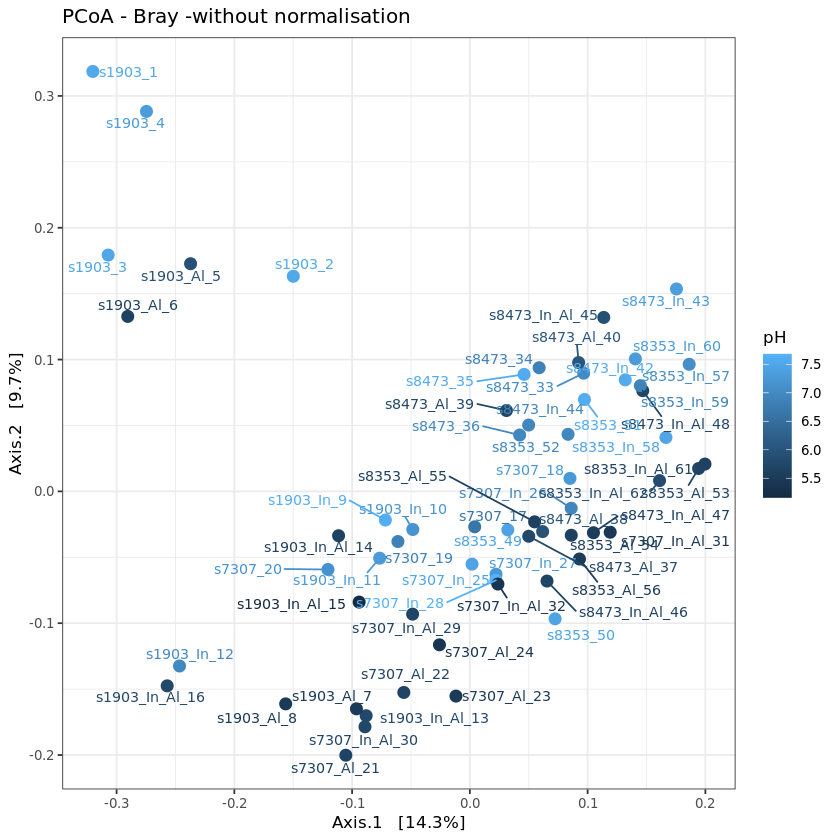

In [12]:
ordination.pure <- phyloseq::ordinate(ps.f, "PCoA", "bray")
p.b.br.wn.pcoa <- plot_ordination(ps.f, ordination.pure, type="sample", color="pH", title="PCoA - Bray -without normalisation", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.pure$vectors), size = 3)
p.b.br.wn.pcoa

without normalisation
NMDS

Square root transformation
Wisconsin double standardization
Run 0 stress 0.1224277 
Run 1 stress 0.1371582 
Run 2 stress 0.1407993 
Run 3 stress 0.1361044 
Run 4 stress 0.1302085 
Run 5 stress 0.1358508 
Run 6 stress 0.1451619 
Run 7 stress 0.1421517 
Run 8 stress 0.1285453 
Run 9 stress 0.1428786 
Run 10 stress 0.1364703 
Run 11 stress 0.1352963 
Run 12 stress 0.1375221 
Run 13 stress 0.1334886 
Run 14 stress 0.1306907 
Run 15 stress 0.1427439 
Run 16 stress 0.1254734 
Run 17 stress 0.1329445 
Run 18 stress 0.1295572 
Run 19 stress 0.1341991 
Run 20 stress 0.1411858 
*** No convergence -- monoMDS stopping criteria:
     1: no. of iterations >= maxit
    19: stress ratio > sratmax


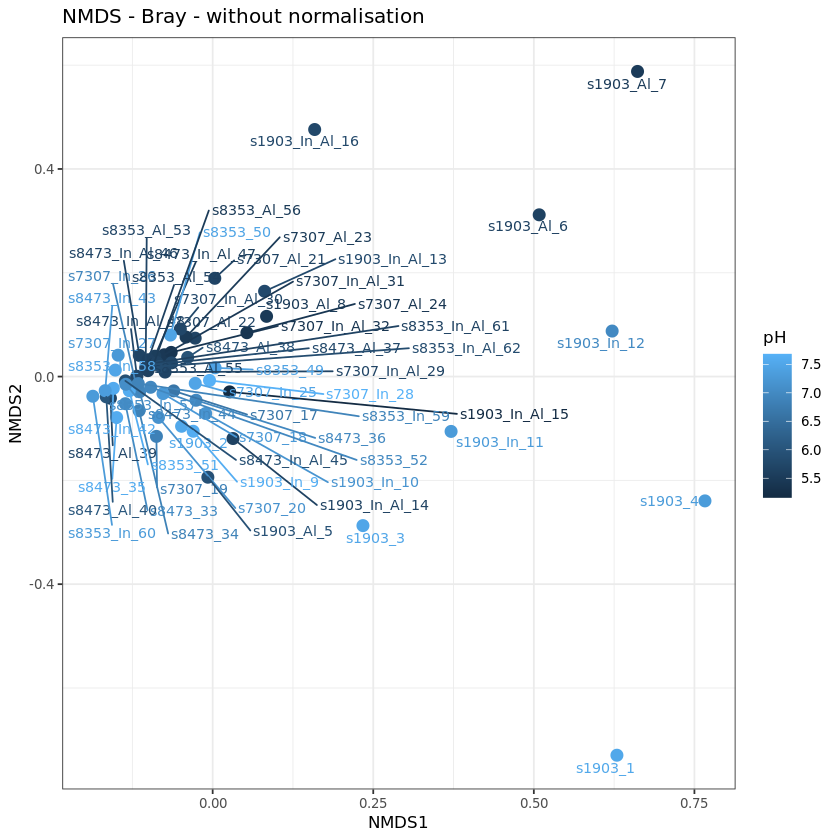

In [13]:
ordination.pure <- phyloseq::ordinate(ps.f, "NMDS", "bray")
p.b.br.wn.nmds <- plot_ordination(ps.f, ordination.pure, type="sample", color="pH", title="NMDS - Bray - without normalisation", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.pure$points), size = 3)
p.b.br.wn.nmds

VST - design - repeats
NMDS

In [ ]:

physeq <- ps.f
veganifyOTU <- function(physeq){
  require(phyloseq)
  if(taxa_are_rows(physeq)){physeq <- t(physeq)}
  return(as(otu_table(physeq), "matrix"))
}
otus <- veganifyOTU(physeq)
meta <- as(sample_data(physeq), "data.frame")
otus <- t(otus)
deseq_counts_by_desc <- DESeqDataSetFromMatrix(otus, colData = meta, design = ~ Description) 
deseq_counts_vst_by_desc <- varianceStabilizingTransformation(deseq_counts_by_desc)
vst_trans_count_tab_descr <- assay(deseq_counts_vst_by_desc)
vst_trans_count_tab_descr
otu.table.desc <- otu_table(vst_trans_count_tab_descr, taxa_are_rows = TRUE)
ps.vst.desc <- physeq
otu_table(ps.vst.desc) <- otu.table.desc
ordination.vst.desc <- ordinate(ps.vst.desc, "PCoA", "bray")
p.b.br.vstr.pcoa <- plot_ordination(ps.vst.desc, ordination.vst.desc, type="sample", color="pH", title="PCoA - Bray - ~ Description", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.vst.desc$vectors), size = 3) 
p.b.br.vstr.pcoa 


VST - design - repeats
NMDS

In [ ]:

physeq <- ps.f
veganifyOTU <- function(physeq){
  require(phyloseq)
  if(taxa_are_rows(physeq)){physeq <- t(physeq)}
  return(as(otu_table(physeq), "matrix"))
}
otus <- veganifyOTU(physeq)
meta <- as(sample_data(physeq), "data.frame")
otus <- t(otus)
deseq_counts_by_desc <- DESeqDataSetFromMatrix(otus, colData = meta, design = ~ Description) 
deseq_counts_vst_by_desc <- varianceStabilizingTransformation(deseq_counts_by_desc)
vst_trans_count_tab_descr <- assay(deseq_counts_vst_by_desc)
vst_trans_count_tab_descr
otu.table.desc <- otu_table(vst_trans_count_tab_descr, taxa_are_rows = TRUE)
ps.vst.desc <- physeq
otu_table(ps.vst.desc) <- otu.table.desc
ordination.vst.desc <- ordinate(ps.vst.desc, "NMDS", "bray")
p.b.br.vstr.nmds <- plot_ordination(ps.vst.desc, ordination.vst.desc, type="sample", color="pH", title="NMDS - Bray - ~ Description", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.vst.desc$points), size = 3) 
p.b.br.vstr.nmds 


VST - design - full
PCoA

In [ ]:

physeq <- ps.f
veganifyOTU <- function(physeq){
  require(phyloseq)
  if(taxa_are_rows(physeq)){physeq <- t(physeq)}
  return(as(otu_table(physeq), "matrix"))
}
otus <- veganifyOTU(physeq)
meta <- as(sample_data(physeq), "data.frame")
levels(meta$Al) <- c("pos", "neg")
levels(meta$Inoculation) <- c("pos", "neg")
otus <- t(otus)
deseq_counts_by_compl <- DESeqDataSetFromMatrix(otus, colData = meta, design = ~ Plant/Al + Plant/Inoculation) 
deseq_counts_vst_by_compl <- varianceStabilizingTransformation(deseq_counts_by_compl)
vst_trans_count_tab_complr <- assay(deseq_counts_vst_by_compl)
vst_trans_count_tab_complr
otu.table.compl <- otu_table(vst_trans_count_tab_complr, taxa_are_rows = TRUE)
ps.vst.compl <- physeq
otu_table(ps.vst.compl) <- otu.table.compl
ordination.vst.compl <- ordinate(ps.vst.compl, "PCoA", "bray")
p.b.br.vstf.pcoa <- plot_ordination(ps.vst.compl, ordination.vst.compl, type="sample", color="pH", title="PCoA - Bray - VST -  ~ Plant/Al + Plant/Inoculation", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.vst.compl$vectors), size = 3) 
p.b.br.vstf.pcoa

VST - design - full
NMDS

In [ ]:

physeq <- ps.f
veganifyOTU <- function(physeq){
  require(phyloseq)
  if(taxa_are_rows(physeq)){physeq <- t(physeq)}
  return(as(otu_table(physeq), "matrix"))
}
otus <- veganifyOTU(physeq)
meta <- as(sample_data(physeq), "data.frame")
levels(meta$Al) <- c("pos", "neg")
levels(meta$Inoculation) <- c("pos", "neg")
otus <- t(otus)
deseq_counts_by_compl <- DESeqDataSetFromMatrix(otus, colData = meta, design = ~ Plant/Al + Plant/Inoculation) 
deseq_counts_vst_by_compl <- varianceStabilizingTransformation(deseq_counts_by_compl)
vst_trans_count_tab_complr <- assay(deseq_counts_vst_by_compl)
vst_trans_count_tab_complr
otu.table.compl <- otu_table(vst_trans_count_tab_complr, taxa_are_rows = TRUE)
ps.vst.compl <- physeq
otu_table(ps.vst.compl) <- otu.table.compl
ordination.vst.compl <- ordinate(ps.vst.compl, "NMDS", "bray")
p.b.br.vstf.nmds <- plot_ordination(ps.vst.compl, ordination.vst.compl, type="sample", color="pH", title="NMDS - Bray - VST -  ~ Plant/Al + Plant/Inoculation", 
                       axes = c(1,2) ) + theme_bw() + theme(text = element_text(size = 10)) +
  geom_point(size = 3) +
  geom_text_repel(label = rownames(ordination.vst.compl$points), size = 3) 
p.b.br.vstf.nmds 

#### all beta in one beta

In [ ]:
ggarrange(p.b.br.wn.pcoa , p.b.br.vstr.pcoa, p.b.br.vstf.pcoa, p.b.br.wn.nmds, p.b.br.vstr.nmds, p.b.br.vstf.nmds, ncol = 3 , nrow = 2, common.legend = TRUE , font.label = list(size = 12, face = "bold", color ="black"))

### reads/otus plot

In [ ]:
plot_rich_reads_samlenames_lm <- function(ps.f){
  rish <- estimate_richness(ps.f, measures = "Observed")
  reads.sum <- as.data.frame(sample_sums(ps.f))
  reads.summary <- cbind(rish, reads.sum)
  colnames(reads.summary) <- c("otus","reads")
  reads.summary["Description"] <- rownames(ps.f@sam_data)
  reads.summary["Repeats"] <- ps.f@sam_data$Description
  reads.summary["Plant"] <- ps.f@sam_data$Plant
  
  library(ggrepel)
  require(ggforce)
  p1 <- ggplot(data=reads.summary) + geom_point(aes(y=otus, x=log2(reads), color=Repeats),size=3) +  geom_text_repel(aes(y=otus, x=log2(reads), label=Description, colour = Repeats)) + theme_bw() +
    geom_smooth(aes(y=otus, x=log2(reads), fill=Repeats, color=Repeats),method=lm, se=FALSE, ymin = 1) + scale_x_continuous(sec.axis = sec_axis(sec.axis ~ 2**.)) 
  # geom_mark_ellipse(aes(y = otus, x=reads, group = Repeats, label = Repeats, color = Repeats), label.fontsize = 10, label.buffer = unit(2, "mm"), label.minwidth = unit(5, "mm"),con.cap = unit(0.1, "mm"))
  
  return(p1)
}
plot_rich_reads_samlenames_lm(ps.f)


### betadispr

Bray
VST by full model normalisation

In [ ]:
dist <- phyloseq::distance(ps.vst.compl, method = "bray", type = "samples")
groups <- ps.vst.compl@sam_data$Description
mod <- vegan::betadisper(dist, groups)
mod.box <- boxplot(mod)
TukeyHSD(mod)

Unifrac
Rarifaed

In [ ]:
ps.rar <- rarefy_even_depth(ps.f,  rngseed = 7788, verbose = FALSE)
dist <- phyloseq::distance(ps.rar, method = "unifrac", type = "samples")
groups <- ps.rar@sam_data$Description
mod <- vegan::betadisper(dist, groups)

mod.box <- boxplot(mod)
TukeyHSD(mod)

Al
Bray
VST by full model normalisation

In [ ]:
dist <- phyloseq::distance(ps.vst.compl, method = "bray", type = "samples")
groups <- ps.vst.compl@sam_data$Al
mod <- vegan::betadisper(dist, groups)
mod.box <- boxplot(mod)
TukeyHSD(mod)

Al
Unifrac
Rarifaed

In [ ]:
ps.rar <- rarefy_even_depth(ps.f,  rngseed = 7788, verbose = FALSE)
dist <- phyloseq::distance(ps.rar, method = "unifrac", type = "samples")
groups <- ps.rar@sam_data$Al
mod <- vegan::betadisper(dist, groups)
mod.box <- boxplot(mod)
TukeyHSD(mod)

In
Bray
VST by full model normalisation

In [ ]:
dist <- phyloseq::distance(ps.vst.compl, method = "bray", type = "samples")
groups <- ps.vst.compl@sam_data$Inoculation
mod <- vegan::betadisper(dist, groups)
mod.box <- boxplot(mod)
TukeyHSD(mod)

In
Unifrac
Rarifaed

  Tukey multiple comparisons of means
    95% family-wise confidence level

Fit: aov(formula = distances ~ group, data = df)

$group
           diff         lwr        upr     p adj
+-- -0.00902475 -0.02109477 0.00304527 0.1399467


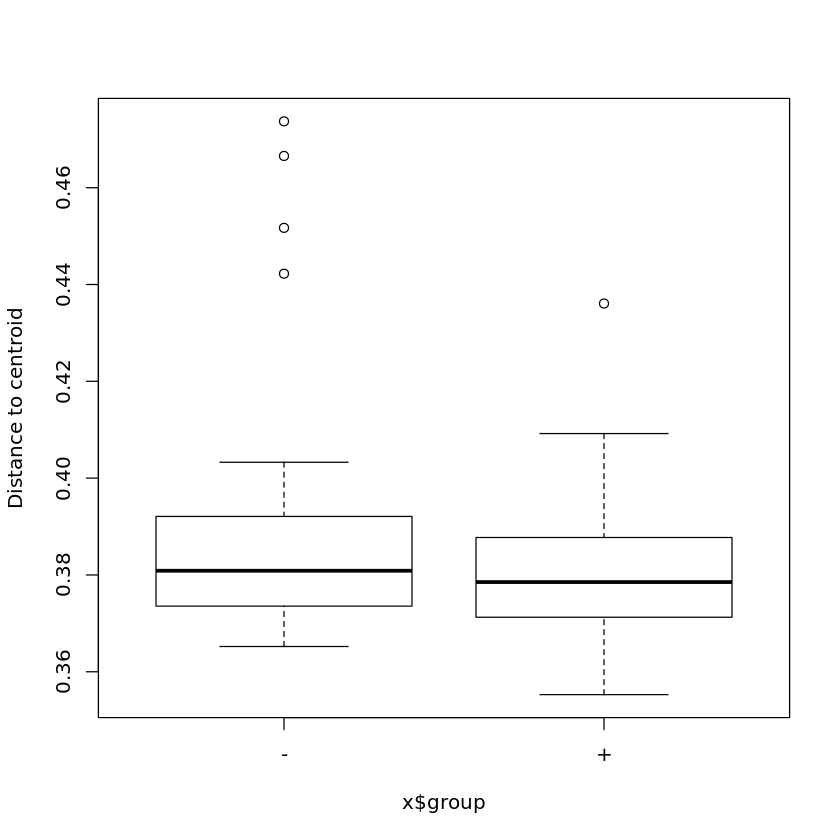

In [15]:

ps.rar <- rarefy_even_depth(ps.f,  rngseed = 7788, verbose = FALSE)
dist <- phyloseq::distance(ps.rar, method = "unifrac", type = "samples")
groups <- ps.rar@sam_data$Inoculation
mod <- vegan::betadisper(dist, groups)
mod.box <- boxplot(mod)
TukeyHSD(mod)

In [ ]:

colnames(vst_trans_count_tab) <- meta$Medium_or_Soil
d.vst <- as.data.frame(vst_trans_count_tab)
t.d.vst <- t(d.vst)
vst.median <- aggregate(t.d.vst, by=list(meta$Medium_or_Soil), median) 
vst.median <- as.data.frame(vst.median)
vst.median$Group.1 <- as.character(vst.median$Group.1) 
vst.median <-  column_to_rownames(vst.median, "Group.1")
vst.median <- t(vst.median)
vst.median <- as.data.frame(vst.median)
vst.median
p.differ <- ggplot(data=vst.median) + geom_point(aes(x = soil, y = medium)) + theme_bw()
p.differ

gbs.core.merged <- vst.median[rownames(gbs.core),]
gbs.core.merged
metadata <- as.data.frame(ps.f@sam_data)
levels(metadata$Al) <- c("pos", "neg")
levels(metadata$Inoculation) <- c("pos", "neg")
metadata

plot(BineM ~ Description, data=metadata)

require(igraph)

In [ ]:
require(igraph)
require(tibble)
require(RColorBrewer)

some_ps <- ps.f
cor.otus <- cor(ps.f@otu_table@.Data, method = "spearman")

tax <- as.data.frame(ps.f@tax_table@.Data)
lev <- levels(tax$Family)
len_lev <- length(lev)
pal <- brewer.pal(len_lev,"Accent")
vertex.col <- pal[tax$Family]

cor.otu <- cor(ps.f@otu_table@.Data, method = "spearman")

cor.otu[cor.otu < .75 ] <- 0
diag(cor.otu) <- 0
new_g <- graph.adjacency(cor.otu, mode='undirected', weighted = 'correlation')
cohesion(new_g)
new_g
cohesion.igraph()


In [8]:
library(heatmaply)
meta <- function(x) {
    df <- as(sample_data(x), "data.frame")
    rownames(df) <- sample_names(x)
    df
}
metadata <- meta(ps.f)
metadata.num <- metadata %>%
  dplyr::select_if(is.numeric) %>% 
  select(-c("QRTPCR", "SeedCa"))

heatmaply(scale(metadata.num), file = 'meta.html')




HTML widgets cannot be represented in plain text (need html)

In [9]:



heatmaply_cor(
  cor(scale(metadata.num)),
  k_col = 2,
  k_row = 2, 
 file = 'cor.meta.html'
  )

HTML widgets cannot be represented in plain text (need html)

In [10]:
r <- cor(scale(metadata.num))
## We use this function to calculate a matrix of p-values from correlation tests
## https://stackoverflow.com/a/13112337/4747043
cor.test.p <- function(x){
    FUN <- function(x, y) cor.test(x, y)[["p.value"]]
    z <- outer(
      colnames(x), 
      colnames(x), 
      Vectorize(function(i,j) FUN(x[,i], x[,j]))
    )
    dimnames(z) <- list(colnames(x), colnames(x))
    z
}
p <- cor.test.p(scale(metadata.num))

heatmaply_cor(
  r,
  node_type = "scatter",
  point_size_mat = -log10(p), 
  point_size_name = "-log10(p-value)",
  label_names = c("x", "y", "Correlation"),
    file = 'p.cor.meta.html'
  
)

HTML widgets cannot be represented in plain text (need html)

In [11]:
r <- cor(scale(metadata.num))
## We use this function to calculate a matrix of p-values from correlation tests
## https://stackoverflow.com/a/13112337/4747043
cor.test.p <- function(x){
    FUN <- function(x, y) cor.test(x, y)[["p.value"]]
    z <- outer(
      colnames(x), 
      colnames(x), 
      Vectorize(function(i,j) FUN(x[,i], x[,j]))
    )
    dimnames(z) <- list(colnames(x), colnames(x))
    z
}
p <- cor.test.p(scale(metadata.num))
p <- as.data.frame(p)
p
library(ggplot2)

heatmaply(p,
  scale_fill_gradient_fun =  ggplot2::scale_fill_gradientn(
    colours = c("red","white","blue"), 
    values = scales::rescale(c(0, 0.05,1)),
    breaks = c(0.05, 0.1),
    guide = "colorbar",
    limits = c(0 , 1)
  ),
    file = 'p.cor.meta.html'
)

,BineM,SeedM,BineSeedM,SeedN,SeedMOne,NodPerPlant,NodPerPlant.1,Mic,Ves,Arb,...,BineSeedPerPlantCu,BineSeedPerPlantFe,BineSeedPerPlantK,BineSeedPerPlantMg,BineSeedPerPlantMo,BineSeedPerPlantNi,BineSeedPerPlantP,BineSeedPerPlantS,BineSeedPerPlantS.1,BineSeedPerPlantZn
BineM,0.000000e+00,7.489718e-14,6.694229e-27,7.413713e-13,1.148927e-02,8.113421e-01,2.294759e-03,1.455431e-02,1.151929e-01,2.605397e-04,...,4.135028e-05,4.223878e-06,5.313297e-11,1.963493e-39,2.016270e-06,8.189738e-06,3.525044e-02,6.929372e-04,1.259389e-08,2.061031e-07
SeedM,7.489718e-14,0.000000e+00,4.026701e-34,1.054934e-06,3.835627e-12,1.364780e-01,4.532977e-02,3.306299e-01,3.310524e-02,1.934130e-02,...,1.683978e-16,5.535656e-15,5.634775e-04,1.898343e-14,1.280180e-13,1.893968e-03,1.163480e-03,1.225407e-14,1.634457e-05,4.024267e-15
BineSeedM,6.694229e-27,4.026701e-34,0.000000e+00,4.659827e-10,3.667342e-07,4.340295e-01,9.541708e-03,9.145987e-02,4.525624e-02,2.162542e-03,...,3.388557e-11,1.472421e-11,6.737753e-07,5.387968e-26,3.158046e-11,9.362056e-05,3.562854e-03,2.715045e-09,1.719497e-07,9.105504e-13
SeedN,7.413713e-13,1.054934e-06,4.659827e-10,0.000000e+00,7.454551e-01,3.043066e-01,2.961543e-01,1.721279e-03,3.899656e-01,4.346141e-05,...,4.783122e-03,2.659472e-03,4.175128e-08,2.146142e-11,3.099981e-02,1.985167e-01,3.107058e-03,4.660481e-02,2.226735e-04,2.720896e-03
SeedMOne,1.148927e-02,3.835627e-12,3.667342e-07,7.454551e-01,0.000000e+00,2.712135e-02,7.598849e-01,3.768374e-01,4.846154e-02,9.831349e-01,...,1.232032e-12,1.058517e-10,9.711969e-01,2.700945e-03,1.944500e-13,2.942364e-03,2.024178e-02,3.569954e-15,3.917570e-02,4.436007e-11
NodPerPlant,8.113421e-01,1.364780e-01,4.340295e-01,3.043066e-01,2.712135e-02,0.000000e+00,2.124068e-11,4.531943e-02,2.389451e-01,4.534750e-02,...,8.650503e-02,8.909326e-02,4.370392e-02,5.737543e-01,4.305307e-01,3.728820e-01,7.473379e-02,8.286406e-02,2.731187e-03,3.699794e-01
NodPerPlant.1,2.294759e-03,4.532977e-02,9.541708e-03,2.961543e-01,7.598849e-01,2.124068e-11,0.000000e+00,5.176037e-01,4.995997e-01,7.127810e-01,...,3.743024e-01,6.462614e-01,1.434596e-03,7.621753e-04,3.190624e-01,1.256979e-01,7.430265e-01,3.972038e-01,2.874298e-06,2.750395e-01
Mic,1.455431e-02,3.306299e-01,9.145987e-02,1.721279e-03,3.768374e-01,4.531943e-02,5.176037e-01,0.000000e+00,2.519576e-08,7.022996e-25,...,4.931121e-01,9.750851e-01,3.276573e-02,8.512363e-02,6.147989e-01,1.516146e-01,7.288169e-02,2.718172e-01,7.554777e-01,4.486380e-01
Ves,1.151929e-01,3.310524e-02,4.525624e-02,3.899656e-01,4.846154e-02,2.389451e-01,4.995997e-01,2.519576e-08,0.000000e+00,4.322531e-04,...,4.317635e-03,1.433738e-02,1.656236e-01,2.257306e-02,2.692025e-03,1.862406e-01,5.653784e-03,3.468977e-03,1.926021e-02,9.476208e-04
Arb,2.605397e-04,1.934130e-02,2.162542e-03,4.346141e-05,9.831349e-01,4.534750e-02,7.127810e-01,7.022996e-25,4.322531e-04,0.000000e+00,...,7.913804e-01,3.445461e-01,5.690588e-03,3.458213e-03,7.276334e-01,9.317156e-02,4.278182e-01,8.322708e-01,6.548575e-01,7.214189e-01


HTML widgets cannot be represented in plain text (need html)

In [16]:
install.packages("heatmaply")

also installing the dependencies 'gdata', 'caTools', 'TSP', 'qap', 'gclus', 'gplots', 'registry', 'plotly', 'dendextend', 'seriation', 'webshot', 'egg'

Updating HTML index of packages in '.Library'
Making 'packages.html' ... done
